# Инференс моделей StyleGAN-NADA

**Цель**  
Загрузка обученных моделей и генерация изображений в различных стилях.

- Загрузка обученных моделей для разных стилей
- Генерация случайных изображений
- Визуализация результатов
- Сравнение разных стилей

## Настройки и импорты


In [1]:
import os
import sys
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import subprocess
import shutil

pretrained_model_dir = "../models"
stylegan_nada_dir = "../stylegan_nada"

# pretrained_model_dir = os.path.join("/content", "models")
# stylegan_nada_dir = os.path.join("/content", "stylegan_nada")

output_dir = "../output"

# Автоматическое клонирование stylegan-nada репозитория
stylegan_nada_abs = os.path.abspath(stylegan_nada_dir)
zssgan_path = os.path.join(stylegan_nada_abs, "ZSSGAN")

def clone_stylegan_nada():
    if os.path.exists(stylegan_nada_abs) and os.path.exists(zssgan_path):
        print(f"Репозиторий stylegan-nada уже существует: {stylegan_nada_abs}")
        return True
    
    print(f"Клонирование репозитория stylegan-nada в {stylegan_nada_abs}...")
    try:
        result = subprocess.run(["git", "--version"], capture_output=True, text=True)
        if result.returncode != 0:
            raise RuntimeError("Git не установлен! Установите Git для клонирования репозитория.")
        
        if os.path.exists(stylegan_nada_abs):
            contents = os.listdir(stylegan_nada_abs)
            if len(contents) == 0 or (len(contents) == 1 and contents[0] == 'ffhq.pt'):
                print(f"Удаление неполной директории {stylegan_nada_abs}...")
                shutil.rmtree(stylegan_nada_abs)
        
        result = subprocess.run(
            ["git", "clone", "https://github.com/rinongal/stylegan-nada.git", stylegan_nada_abs],
            capture_output=True,
            text=True,
            timeout=300
        )
        
        if result.returncode == 0 and os.path.exists(zssgan_path):
            print(f"Репозиторий успешно клонирован: {stylegan_nada_abs}")
            return True
        else:
            raise RuntimeError(f"Ошибка при клонировании: {result.stderr}")
    except subprocess.TimeoutExpired:
        raise RuntimeError("Таймаут при клонировании репозитория. Попробуйте позже.")
    except Exception as e:
        raise RuntimeError(f"Ошибка при клонировании репозитория: {e}")

clone_stylegan_nada()

if os.path.exists(stylegan_nada_abs) and os.path.exists(zssgan_path):
    sys.path.insert(0, stylegan_nada_abs)
    sys.path.insert(0, zssgan_path)
    print(f"Пути добавлены в sys.path")
else:
    raise FileNotFoundError(f"ZSSGAN не найден в {zssgan_path}")

def download_ffhq_model():
    os.makedirs(pretrained_model_dir, exist_ok=True)
    model_path = os.path.join(pretrained_model_dir, "ffhq.pt")
    
    if os.path.exists(model_path):
        print(f"Базовая модель FFHQ уже существует: {model_path}")
        return model_path
    
    print(f"Скачивание базовой модели FFHQ в {model_path}...")
    try:
        import gdown
        url = "https://drive.google.com/uc?id=1EM87UquaoQmk17Q8d5kYIAHqu0dkYqdT"
        gdown.download(url, model_path, quiet=False)
        
        if os.path.exists(model_path):
            print(f"Модель успешно скачана: {model_path}")
            return model_path
        else:
            raise RuntimeError("Не удалось скачать модель")
    except ImportError:
        print("Установка gdown для скачивания модели")
        subprocess.check_call([sys.executable, "-m", "pip", "install", "gdown", "-q"])
        import gdown
        url = "https://drive.google.com/uc?id=1EM87UquaoQmk17Q8d5kYIAHqu0dkYqdT"
        gdown.download(url, model_path, quiet=False)
        if os.path.exists(model_path):
            print(f"Модель успешно скачана: {model_path}")
            return model_path
        else:
            raise RuntimeError("Не удалось скачать модель")
    except Exception as e:
        raise RuntimeError(f"Ошибка при скачивании модели: {e}")

base_model_path = download_ffhq_model()

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Используется устройство: {device}")

if device == "cpu":
    import sys
    script_dir = os.path.dirname(os.path.abspath(__file__)) if "__file__" in globals() else os.getcwd()
    setup_script = os.path.join(os.path.dirname(script_dir), "setup_cpu_support.py")
    if not os.path.exists(setup_script):
        setup_script = "../setup_cpu_support.py"
    
    if os.path.exists(setup_script):
        print("Применение CPU-поддержки к stylegan-nada...")
        sys.path.insert(0, os.path.dirname(setup_script))
        try:
            from setup_cpu_support import setup_cpu_support
            setup_cpu_support(stylegan_nada_abs)
            print("CPU-поддержка применена")
        except Exception as e:
            print(f"Предупреждение: не удалось применить CPU-поддержку: {e}")
    else:
        print(f"Предупреждение: скрипт setup_cpu_support.py не найден по пути {setup_script}")

Репозиторий stylegan-nada уже существует: /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada
Пути добавлены в sys.path
Базовая модель FFHQ уже существует: ../models/ffhq.pt
Используется устройство: cpu
Применение CPU-поддержки к stylegan-nada...
Устройство: CPU
Применение CPU-поддержки к файлам stylegan-nada...
Найдена директория stylegan_nada: /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada
Применение CPU-поддержки к /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada/ZSSGAN/op/fused_act.py...
CPU-поддержка уже применена к /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada/ZSSGAN/op/fused_act.py
Применение CPU-поддержки к /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada/ZSSGAN/op/upfirdn2d.py...
CPU-поддержка уже применена к /home/bychkova/Downloads/DLS/final-project-dls/stylegan_nada/ZSSGAN/op/upfirdn2d.py
CPU-поддержка успешно применена ко всем файлам!
CPU-поддержка применена


## Функции загрузки моделей


In [2]:
from ZSSGAN.model.sg2_model import Generator
from ZSSGAN.model.ZSSGAN import SG2Generator

In [4]:
def load_base_generator(base_model_path, size=1024, device='cpu'):
    if not os.path.exists(base_model_path):
        raise FileNotFoundError(f"Базовая модель не найдена: {base_model_path}")
    
    checkpoint = torch.load(base_model_path, map_location=device)
    
    generator = Generator(
        size=size,
        style_dim=512,
        n_mlp=8,
        channel_multiplier=2
    )
    
    if 'g_ema' in checkpoint:
        generator.load_state_dict(checkpoint['g_ema'], strict=False)
    elif 'g' in checkpoint:
        generator.load_state_dict(checkpoint['g'], strict=False)
    else:
        generator.load_state_dict(checkpoint, strict=False)
    
    generator = generator.to(device)
    generator.eval()
    
    print("Базовая модель загружена")
    return generator

In [5]:
def load_style_model(model_path, base_generator, device='cpu', use_sg2_wrapper=False, base_model_path=None):
    print(f"Загрузка модели стиля из {model_path}...")
    
    if not os.path.exists(model_path):
        raise FileNotFoundError(f"Модель стиля не найдена: {model_path}")
    
    checkpoint = torch.load(model_path, map_location=device)
    
    if use_sg2_wrapper:
    
        print("Используем SG2Generator обертку для совместимости...")
        
        if base_model_path is None:
            if 'pretrained_model_dir' in globals():
                base_model_path = os.path.join(pretrained_model_dir, "ffhq.pt")
            else:
                base_model_path = os.path.join(os.path.dirname(os.path.dirname(model_path)), "models", "ffhq.pt")
        
        if not os.path.exists(base_model_path):
            raise FileNotFoundError(f"Базовая модель не найдена: {base_model_path}")
        
        generator_wrapper = SG2Generator(base_model_path, img_size=base_generator.size, device=device)
        
        if 'generator_state_dict' in checkpoint:
            state_dict = checkpoint['generator_state_dict']
            new_state_dict = {}
            for key, value in state_dict.items():
                if key.startswith('generator.'):
                    new_key = key[len('generator.'):]
                    new_state_dict[new_key] = value
                else:
                    new_state_dict[key] = value
            
            generator_wrapper.generator.load_state_dict(new_state_dict, strict=False)
            print(f"Загружены веса в SG2Generator ({len(new_state_dict)} параметров)")
        else:
            print("generator_state_dict не найден, используем базовую модель")
        
        generator_wrapper.eval()
        generator = generator_wrapper 
    else:
        generator = Generator(
            size=base_generator.size,
            style_dim=512,
            n_mlp=8,
            channel_multiplier=2
        )
        
        generator.load_state_dict(base_generator.state_dict())
        print("Загружены базовые веса")
        
        if 'generator_state_dict' in checkpoint:
            state_dict = checkpoint['generator_state_dict']
            new_state_dict = {}
            for key, value in state_dict.items():
                if key.startswith('generator.'):
                    new_key = key[len('generator.'):]
                    new_state_dict[new_key] = value
                else:
                    new_state_dict[key] = value
            
            missing_keys, unexpected_keys = generator.load_state_dict(new_state_dict, strict=False)
            if missing_keys:
                print(f"Отсутствующие ключи ({len(missing_keys)}): {missing_keys[:5]}...")
            if unexpected_keys:
                print(f"Неожиданные ключи ({len(unexpected_keys)}): {unexpected_keys[:5]}...")
            print(f"Загружены обученные веса ({len(new_state_dict)} параметров)")
        elif 'trainable_state_dict' in checkpoint:
            trainable_dict = checkpoint['trainable_state_dict']
            new_trainable_dict = {}
            for key, value in trainable_dict.items():
                if key.startswith('generator.'):
                    new_key = key[len('generator.'):]
                    new_trainable_dict[new_key] = value
                else:
                    new_trainable_dict[key] = value
            
            state_dict = generator.state_dict()
            for name, param in generator.named_parameters():
                if name in new_trainable_dict:
                    state_dict[name] = new_trainable_dict[name]
            generator.load_state_dict(state_dict, strict=False)
            print("Применены trainable_state_dict веса")
        else:
            print("Не найден generator_state_dict или trainable_state_dict")
            print("Используем базовую модель")
        
        generator = generator.to(device)
        generator.eval()
    
    metadata = checkpoint.get('metadata', {})
    
    print("Модель стиля загружена")
    if metadata:
        print(f"Стиль: {metadata.get('target_class', 'неизвестно')}")
        print(f"Заморожено слоев: {metadata.get('freeze_layers', 'неизвестно')}")
    
    return generator, metadata

## Функции генерации изображений


In [6]:
def generate_images(generator, num_images=4, truncation=0.7, seed=None, device='cpu', batch_size=1):
    if seed is not None:
        torch.manual_seed(seed)
        np.random.seed(seed)
    
    generator.eval()
    
    truncation_latent = None
    if truncation < 1:
        with torch.no_grad():
            if hasattr(generator, 'generator') and hasattr(generator, 'mean_latent'):
                truncation_latent = generator.mean_latent
            elif hasattr(generator, 'mean_latent') and callable(generator.mean_latent):
                truncation_latent = generator.mean_latent(n_latent=2048)
            else:
                w_avg_samples = []
                for _ in range(1000):
                    z_sample = torch.randn(1, 512, device=device)
                    if hasattr(generator, 'generator'):
                        w_sample = generator.generator.style(z_sample)
                    else:
                        w_sample = generator.style(z_sample)
                    w_avg_samples.append(w_sample)
                truncation_latent = torch.cat(w_avg_samples, dim=0).mean(dim=0, keepdim=True)
            
            if device == 'cuda':
                truncation_latent = truncation_latent.cpu()
    
    all_images = []
    all_latents = []
    
    with torch.no_grad():
        for i in range(0, num_images, batch_size):
            current_batch_size = min(batch_size, num_images - i)
            
            z = torch.randn(current_batch_size, 512, device=device)
            
            if truncation < 1 and truncation_latent is not None:
                if device == 'cuda':
                    truncation_latent_device = truncation_latent.to(device)
                else:
                    truncation_latent_device = truncation_latent
            else:
                truncation_latent_device = None
            
            images, _ = generator(
                [z], 
                truncation=truncation,
                truncation_latent=truncation_latent_device
            )
            
            images_cpu = images.cpu()
            z_cpu = z.cpu()
            
            all_images.append(images_cpu)
            all_latents.append(z_cpu)
            
            del images, z
            if truncation_latent_device is not None and device == 'cuda':
                del truncation_latent_device
            if device == 'cuda':
                torch.cuda.empty_cache()
    
    images = torch.cat(all_images, dim=0)
    latents = torch.cat(all_latents, dim=0)
    
    return images, latents

def tensor_to_image(tensor):
    if tensor.dim() == 4:
        images = []
        for i in range(tensor.shape[0]):
            img_tensor = tensor[i]
            img_np = ((img_tensor.permute(1, 2, 0).cpu().numpy() + 1) / 2 * 255).clip(0, 255).astype(np.uint8)
            images.append(Image.fromarray(img_np))
        return images
    else:
        img_np = ((tensor.permute(1, 2, 0).cpu().numpy() + 1) / 2 * 255).clip(0, 255).astype(np.uint8)
        return Image.fromarray(img_np)

def visualize_images(images, titles=None, figsize=(15, 4)):
    if isinstance(images, torch.Tensor):
        images = tensor_to_image(images)
    
    num_images = len(images)
    cols = min(4, num_images)
    rows = (num_images + cols - 1) // cols
    
    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    if num_images == 1:
        axes = [axes]
    else:
        axes = axes.flatten() if rows > 1 else axes
    
    for i, img in enumerate(images):
        axes[i].imshow(img)
        axes[i].axis('off')
        if titles and i < len(titles):
            axes[i].set_title(titles[i], fontsize=10)
    
    for i in range(num_images, len(axes)):
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

## Загрузка базовой модели


In [7]:
base_model_path = os.path.join(pretrained_model_dir, "ffhq.pt")
base_generator = load_base_generator(base_model_path, size=1024, device=device)

Базовая модель загружена


## Поиск доступных моделей


In [10]:
def find_available_models(models_dir):
    available_models = {}
    
    if not os.path.exists(models_dir):
        print(f"Директория {models_dir} не найдена")
        return available_models
    
    for root, _, files in os.walk(models_dir):
        for file in files:
            if file.startswith("final_model_") and file.endswith(".pt"):
                model_path = os.path.join(root, file)
                
                # извлекаем имя стиля из пути
                # например: output/anime_style_freeze_0/final_model_anime_style_freeze_0.pt
                rel_path = os.path.relpath(model_path, models_dir)
                parts = rel_path.split(os.sep)
                
                if len(parts) >= 1:
                    exp_name = parts[0]  # anime_style_freeze_0
                    
                    try:
                        checkpoint = torch.load(model_path, map_location='cpu')
                        metadata = checkpoint.get('metadata', {})
                        
                        available_models[exp_name] = {
                            'path': model_path,
                            'metadata': metadata,
                            'experiment_name': exp_name
                        }
                    except Exception as e:
                        print(f"Ошибка при загрузке {model_path}: {e}")
    
    return available_models

available_models = find_available_models(pretrained_model_dir)

print(f"Найдено моделей: {len(available_models)}")
print("Доступные модели:")
for name, info in available_models.items():
    metadata = info.get('metadata', {})
    target_class = metadata.get('target_class', 'неизвестно')
    freeze_layers = metadata.get('freeze_layers', 'неизвестно')
    print(f"{name}")
    print(f"    Стиль: {target_class[:60]}...")
    print(f"    Заморожено слоев: {freeze_layers}")

Найдено моделей: 12
Доступные модели:
final_model_anime_style_freeze_0.pt
    Стиль: anime character, Japanese anime style, cel-shaded, vibrant c...
    Заморожено слоев: 0
final_model_anime_style_freeze_2.pt
    Стиль: anime character, Japanese anime style, cel-shaded, vibrant c...
    Заморожено слоев: 2
final_model_joker_style_freeze_0.pt
    Стиль: the Joker from Batman, green hair, white face, red lips, cre...
    Заморожено слоев: 0
final_model_joker_style_freeze_2.pt
    Стиль: the Joker from Batman, green hair, white face, red lips, cre...
    Заморожено слоев: 2
final_model_joker_style_freeze_4.pt
    Стиль: the Joker from Batman, green hair, white face, red lips, cre...
    Заморожено слоев: 4
final_model_oil_painting_style_freeze_0.pt
    Стиль: oil painting, brush strokes, artistic, textured, classical p...
    Заморожено слоев: 0
final_model_oil_painting_style_freeze_2.pt
    Стиль: oil painting, brush strokes, artistic, textured, classical p...
    Заморожено слоев: 2
fin

## Генерация изображений и сохранение


In [11]:
def save_generated_images(images, output_dir, prefix="generated", metadata=None):
    os.makedirs(output_dir, exist_ok=True)
    
    if isinstance(images, torch.Tensor):
        images = tensor_to_image(images)
    
    saved_paths = []
    for i, img in enumerate(images):
        if metadata:
            style_name = metadata.get('experiment_name', 'unknown')
            filename = f"{prefix}_{style_name}_{i+1:03d}.png"
        else:
            filename = f"{prefix}_{i+1:03d}.png"
        
        filepath = os.path.join(output_dir, filename)
        img.save(filepath)
        saved_paths.append(filepath)
        print(f"Сохранено: {filepath}")
    
    return saved_paths

Загрузка модели стиля из ../models/final_model_anime_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: anime character, Japanese anime style, cel-shaded, vibrant colors, large expressive eyes
Заморожено слоев: 0
Модель: final_model_anime_style_freeze_0.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


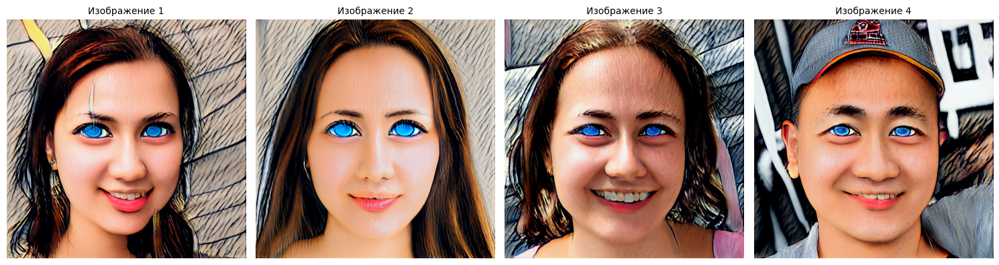

Сохранено: inference_output/generated_final_model_anime_style_freeze_0.pt_001.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_0.pt_002.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_0.pt_003.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_0.pt_004.png
Загрузка модели стиля из ../models/final_model_anime_style_freeze_2.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: anime character, Japanese anime style, cel-shaded, vibrant colors, large expressive eyes
Заморожено слоев: 2
Модель: final_model_anime_style_freeze_2.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


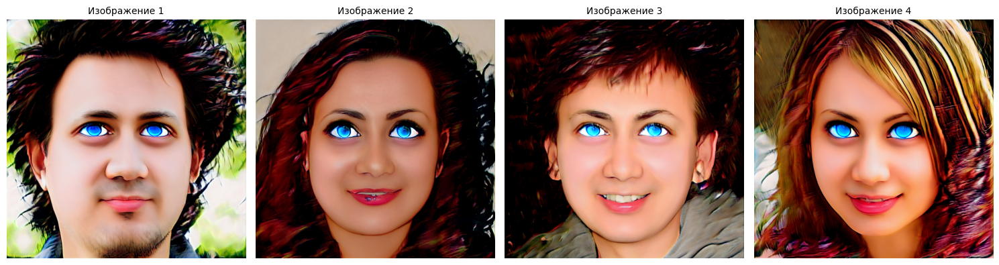

Сохранено: inference_output/generated_final_model_anime_style_freeze_2.pt_001.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_2.pt_002.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_2.pt_003.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_2.pt_004.png
Загрузка модели стиля из ../models/final_model_joker_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: the Joker from Batman, green hair, white face, red lips, creepy smile, makeup
Заморожено слоев: 0
Модель: final_model_joker_style_freeze_0.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


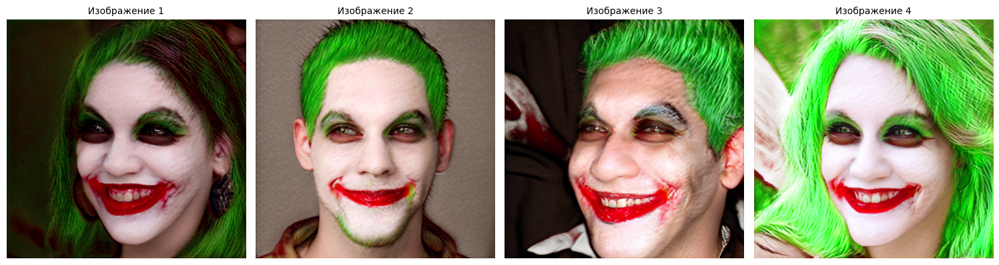

Сохранено: inference_output/generated_final_model_joker_style_freeze_0.pt_001.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_0.pt_002.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_0.pt_003.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_0.pt_004.png
Загрузка модели стиля из ../models/final_model_joker_style_freeze_2.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: the Joker from Batman, green hair, white face, red lips, creepy smile, makeup
Заморожено слоев: 2
Модель: final_model_joker_style_freeze_2.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


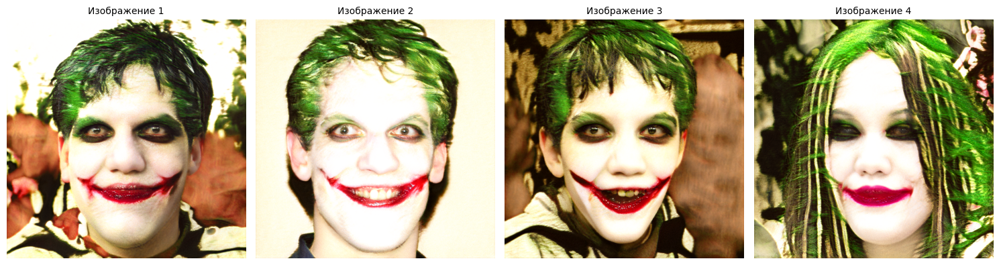

Сохранено: inference_output/generated_final_model_joker_style_freeze_2.pt_001.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_2.pt_002.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_2.pt_003.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_2.pt_004.png
Загрузка модели стиля из ../models/final_model_joker_style_freeze_4.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: the Joker from Batman, green hair, white face, red lips, creepy smile, makeup
Заморожено слоев: 4
Модель: final_model_joker_style_freeze_4.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


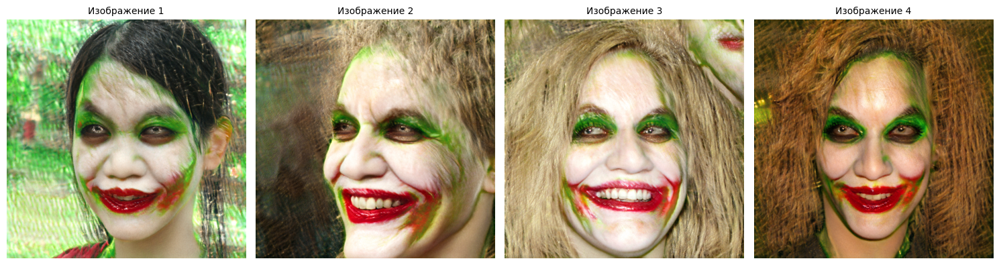

Сохранено: inference_output/generated_final_model_joker_style_freeze_4.pt_001.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_4.pt_002.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_4.pt_003.png
Сохранено: inference_output/generated_final_model_joker_style_freeze_4.pt_004.png
Загрузка модели стиля из ../models/final_model_oil_painting_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: oil painting, brush strokes, artistic, textured, classical painting style, canvas texture
Заморожено слоев: 0
Модель: final_model_oil_painting_style_freeze_0.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


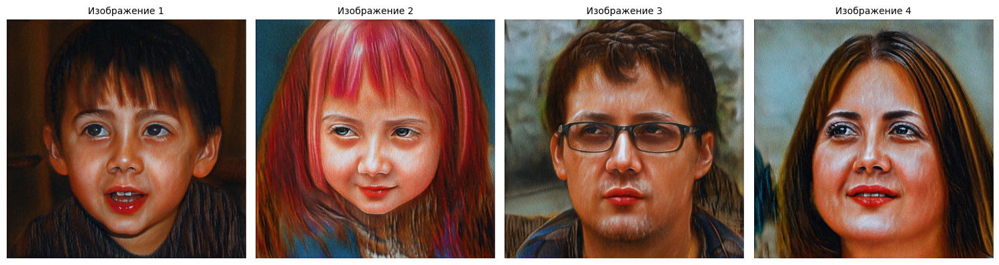

Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_0.pt_001.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_0.pt_002.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_0.pt_003.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_0.pt_004.png
Загрузка модели стиля из ../models/final_model_oil_painting_style_freeze_2.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: oil painting, brush strokes, artistic, textured, classical painting style, canvas texture
Заморожено слоев: 2
Модель: final_model_oil_painting_style_freeze_2.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


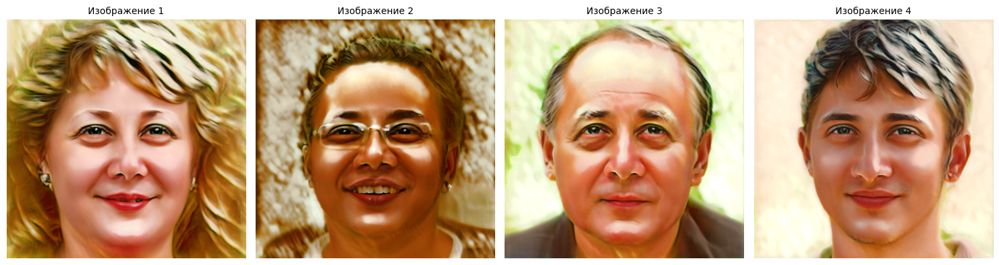

Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_2.pt_001.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_2.pt_002.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_2.pt_003.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_2.pt_004.png
Загрузка модели стиля из ../models/final_model_oil_painting_style_freeze_4.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: oil painting, brush strokes, artistic, textured, classical painting style, canvas texture
Заморожено слоев: 4
Модель: final_model_oil_painting_style_freeze_4.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


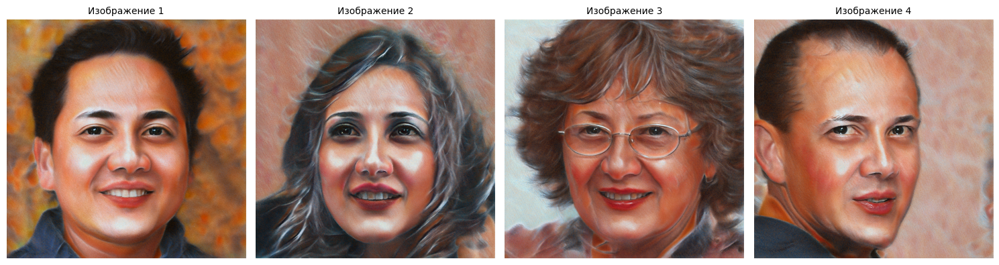

Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_4.pt_001.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_4.pt_002.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_4.pt_003.png
Сохранено: inference_output/generated_final_model_oil_painting_style_freeze_4.pt_004.png
Загрузка модели стиля из ../models/final_model_sketch_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: sketch, pencil drawing, hand-drawn, monochrome, artistic sketch, black and white drawing
Заморожено слоев: 0
Модель: final_model_sketch_style_freeze_0.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


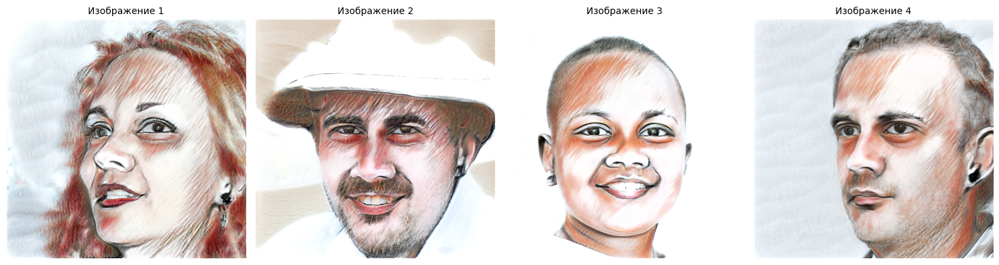

Сохранено: inference_output/generated_final_model_sketch_style_freeze_0.pt_001.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_0.pt_002.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_0.pt_003.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_0.pt_004.png
Загрузка модели стиля из ../models/final_model_sketch_style_freeze_2.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: sketch, pencil drawing, hand-drawn, monochrome, artistic sketch, black and white drawing
Заморожено слоев: 2
Модель: final_model_sketch_style_freeze_2.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


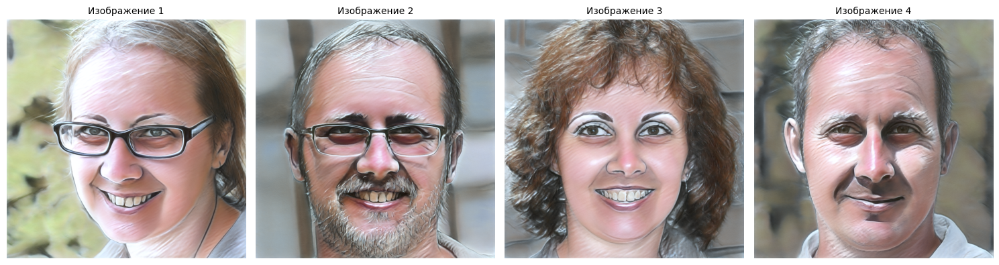

Сохранено: inference_output/generated_final_model_sketch_style_freeze_2.pt_001.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_2.pt_002.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_2.pt_003.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_2.pt_004.png
Загрузка модели стиля из ../models/final_model_sketch_style_freeze_4.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: sketch, pencil drawing, hand-drawn, monochrome, artistic sketch, black and white drawing
Заморожено слоев: 4
Модель: final_model_sketch_style_freeze_4.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


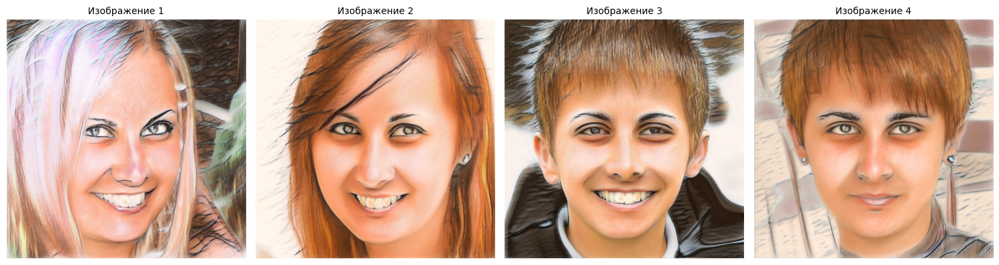

Сохранено: inference_output/generated_final_model_sketch_style_freeze_4.pt_001.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_4.pt_002.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_4.pt_003.png
Сохранено: inference_output/generated_final_model_sketch_style_freeze_4.pt_004.png
Загрузка модели стиля из ../models/final_model_anime_style_freeze_4.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: anime character, Japanese anime style, cel-shaded, vibrant colors, large expressive eyes
Заморожено слоев: 4
Модель: final_model_anime_style_freeze_4.pt
   Размер: torch.Size([4, 3, 1024, 1024])
   Truncation: 0.7
   Seed: None


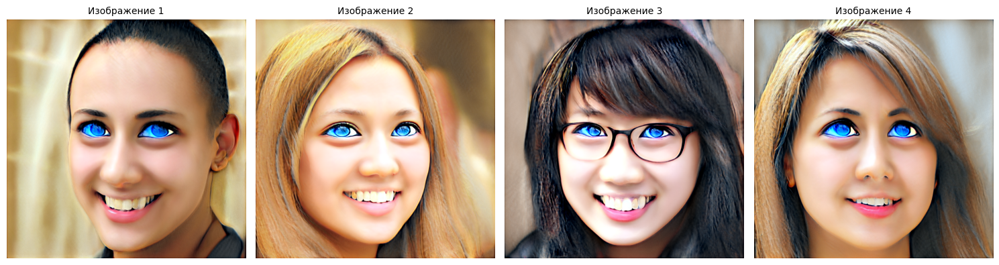

Сохранено: inference_output/generated_final_model_anime_style_freeze_4.pt_001.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_4.pt_002.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_4.pt_003.png
Сохранено: inference_output/generated_final_model_anime_style_freeze_4.pt_004.png


In [12]:
# Параметры генерации
num_images = 4  
truncation = 0.7
seed = None  
batch_size = 1  

save_dir = "inference_output"

for name in available_models.keys():
    model_info = available_models[name]
    model_path = model_info['path']
    style_generator, metadata = load_style_model(
        model_path, 
        base_generator, 
        device=device, 
        use_sg2_wrapper=True,
        base_model_path=base_model_path
    )
    images, latents = generate_images(
        style_generator, 
        num_images=num_images, 
        truncation=truncation, 
        seed=seed,
        device=device,
        batch_size=batch_size  
    )
    
    print(f"Модель: {name}")
    print(f"   Размер: {images.shape}")
    print(f"   Truncation: {truncation}")
    print(f"   Seed: {seed}")
    
    target_class = metadata.get('target_class', 'неизвестный стиль')
    visualize_images(images, titles=[f"Изображение {i+1}" for i in range(num_images)])
    save_generated_images(images, save_dir, prefix="generated", metadata={'experiment_name': name})


## Сравнение разных стилей


Загрузка final_model_anime_style_freeze_0.pt...
Загрузка модели стиля из ../models/final_model_anime_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: anime character, Japanese anime style, cel-shaded, vibrant colors, large expressive eyes
Заморожено слоев: 0
Загрузка final_model_anime_style_freeze_2.pt...
Загрузка модели стиля из ../models/final_model_anime_style_freeze_2.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: anime character, Japanese anime style, cel-shaded, vibrant colors, large expressive eyes
Заморожено слоев: 2
Загрузка final_model_joker_style_freeze_0.pt...
Загрузка модели стиля из ../models/final_model_joker_style_freeze_0.pt...
Используем SG2Generator обертку для совместимости...
Загружены веса в SG2Generator (171 параметров)
Модель стиля загружена
Стиль: the Joker from Batman, gre

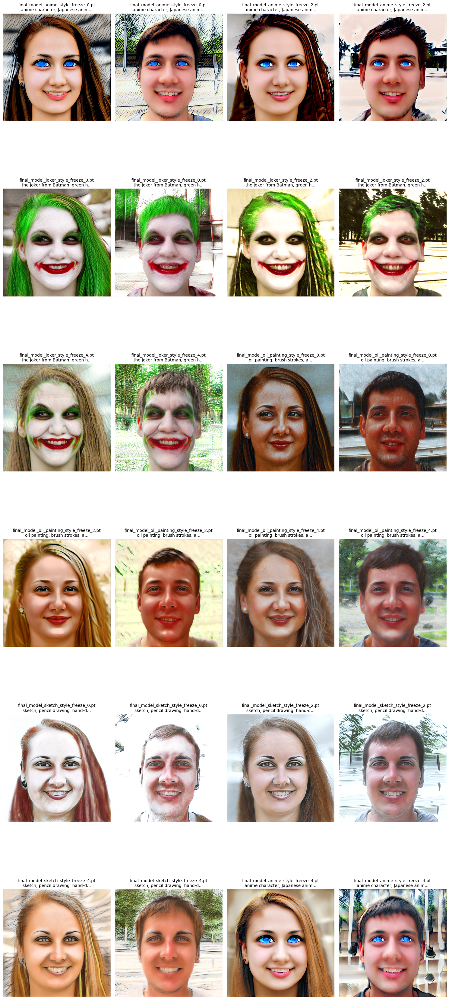

In [13]:
def compare_styles(available_models, base_generator, style_names, num_images=2, truncation=0.7, seed=42, device='cpu'):
    all_images = []
    all_titles = []
    
    for style_name in style_names:
        if style_name not in available_models:
            print(f"Модель '{style_name}' не найдена, пропускаем")
            continue
        
        print(f"Загрузка {style_name}...")
        model_info = available_models[style_name]
        model_path = model_info['path']
        
        base_model_path = os.path.join(pretrained_model_dir, "ffhq.pt")
        style_gen, metadata = load_style_model(
            model_path, 
            base_generator, 
            device=device, 
            use_sg2_wrapper=True,
            base_model_path=base_model_path
        )
        
        images, _ = generate_images(style_gen, num_images=num_images, truncation=truncation, seed=seed, device=device)
        
        pil_images = tensor_to_image(images)
        all_images.extend(pil_images)
        
        target_class = metadata.get('target_class', style_name)
        for i in range(num_images):
            all_titles.append(f"{style_name}\n{target_class[:30]}...")
        
        del style_gen
        if device == 'cuda':
            torch.cuda.empty_cache()
    
    if all_images:
        visualize_images(all_images, titles=all_titles, figsize=(15, len(style_names) * 3))
    else:
        print("Не удалось загрузить модели для сравнения")

compare_styles(available_models, base_generator, available_models.keys(), num_images=2, device=device)
